## Advanced Lane Finding Project
**Douglas Wirtz**

**February 10th, 2017**

---
The goals / steps of this project are the following:

1. Import dependencies and functions
2. Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
3. Apply a distortion correction to raw images.
4. Use color transforms, gradients, etc., to create a thresholded binary image.
5. Apply a perspective transform to rectify a binary image ("birds-eye view").
6. Detect lane pixels and fit to find the lane boundary.
7. Determine the curvature of the lane and vehicle position with respect to center.
8. Warp the detected lane boundaries back onto the original image.
9. Output visual display of the lane boundaries, numerical estimation of lane curvature, and vehicle position.
10. Run pipeline on project video.
---

### 1. Import dependencies and functions

In [1]:
# Import dependencies
import numpy as np
import os
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

# Import functions
# Convert to grayscale
def grayscale(img):
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

# Undistort an image given the calibration matrix and distortion coefficients
def undistort(img, mtx, dist):
    return cv2.undistort(img, mtx, dist, None, None)

def gaussian_blur(img, kernel=5):
    # Apply Gaussian Blur
    blur = cv2.GaussianBlur(img,(kernel,kernel),0)
    return blur

# Define a function that thresholds the S-channel of HLS
def y_w_color_filter(img):
    # Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    #Filter out all colors except yellow and white
    lower_yellow = np.array([0, 0, 40])
    upper_yellow = np.array([100, 255, 255])
    lower_white = np.array([0, 160, 0])
    upper_white = np.array([255, 255, 255])
    ymask = cv2.inRange(hls, lower_yellow, upper_yellow)
    wmask = cv2.inRange(hls, lower_white, upper_white)
    mask = np.logical_or(ymask, wmask)
    return mask

# Convert to HLS color space
def hls_select(img, hls_channel='s', hls_thresh=(0, 255)):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    if hls_channel == 'h':
        channel_select = hls[:,:,0]
    if hls_channel == 'l':
        channel_select = hls[:,:,1]
    if hls_channel == 's':
        channel_select = hls[:,:,2]
    binary_output = np.zeros_like(channel_select)
    binary_output[(channel_select >= hls_thresh[0]) & (channel_select <= hls_thresh[1])] = 1
    return binary_output

# Applying Sobel threshold to binary output
def sobel_thresh(img, orient='x', sobel_thresh=(0, 255)):
    gray = grayscale(img)
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= sobel_thresh[0]) & (scaled_sobel <= sobel_thresh[1])] = 1
    return binary_output 

# Applying a threshold to the gradient magnitude to a binary output
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    gray = grayscale(img)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
    return binary_output

#Applying a threshold to the direction of the gradient to a binary output
def dir_thresh(img, sobel_kernel=3, dir_thresh=(0, np.pi/2)):
    gray = grayscale(img)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= dir_thresh[0]) & (absgraddir <= dir_thresh[1])] = 1
    return binary_output

# Apply a mask to the image given vertices for region of interest
def mask(img, vertices):
    mask = np.zeros_like(img)   
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255   
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

# Get source and destination points for perspective transform
def get_src_dst(vert, img_size):
    src = np.float32(
        [[vert[0][0][0], vert[0][0][1]],
         [vert[0][1][0], vert[0][1][1]],
         [vert[0][2][0], vert[0][2][1]],
         [vert[0][3][0], vert[0][3][1]]])
    
    dst = np.float32(
        [[img_size[0] / 4, vert[0][0][1]],
         [img_size[0] / 4, 0],
         [img_size[0] * 3 / 4, 0],
         [img_size[0] * 3 / 4, vert[0][3][1]]])
    return src, dst

# Perform a perspective transform to return a warped image
def warp(img, vertices):
    img_size = (img.shape[1], img.shape[0])
    src, dst = get_src_dst(vertices, img_size)
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return warped, M, Minv

def fit_lines(warped, margin, minpix, nwindows, window_height):
    # Use global variables to save previous frame's lane fits
    global set_prev
    global left_fit_prev
    global right_fit_prev
    
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((warped, warped, warped))*255
    if set_prev == 0:
        # Take a histogram of the bottom half of the image
        histogram = np.sum(warped[warped.shape[0]/2:,:], axis=0)
        # Find the peak of the left and right halves of the histogram
        # These will be the starting point for the left and right lines
        midpoint = np.int(histogram.shape[0]/2)
        leftx_base = np.argmax(histogram[:midpoint])
        rightx_base = np.argmax(histogram[midpoint:]) + midpoint
        # Current positions to be updated for each window
        leftx_current = leftx_base
        rightx_current = rightx_base
        leftx_prev = leftx_current
        rightx_prev = rightx_current
        # Create empty lists to receive left and right lane pixel indices
        left_lane_inds = []
        right_lane_inds = []

        # Step through the windows one by one
        for window in range(nwindows):
            # If difference between current and previous is more than 60 pixels, use previous
            if np.abs(leftx_current-leftx_prev)>=60:
                leftx_current = leftx_prev
            if np.abs(rightx_current-rightx_prev)>=60:
                rightx_current = rightx_prev
            # Identify window boundaries in x and y (and right and left)
            win_y_low = warped.shape[0] - (window+1)*window_height
            win_y_high = warped.shape[0] - window*window_height
            win_xleft_low = leftx_current - margin
            win_xleft_high = leftx_current + margin
            win_xright_low = rightx_current - margin
            win_xright_high = rightx_current + margin
            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
            # Identify the nonzero pixels in x and y within the window
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)
            # If you found > minpix pixels, recenter next window on their mean position
            if len(good_left_inds) > minpix:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            if len(good_right_inds) > minpix:        
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
            # Set new previous left and right
            leftx_prev = leftx_current
            rightx_prev = rightx_current

        # Concatenate the arrays of indices
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    
    if set_prev == 1:
        margin = 45
        left_fit = left_fit_prev
        right_fit = right_fit_prev
        left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
        right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    left_fit_prev = left_fit
    right_fit_prev = right_fit
    
    if set_prev == 0:
        set_prev = 1

    # Compute curve radii
    left_curverad, right_curverad = find_curvature(leftx, rightx, lefty, righty, warped.shape[0]/2)
    
    # Compute the car position relative to center
    car_pos = find_car_position(left_fit, right_fit, warped)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    return out_img, left_lane_inds, right_lane_inds, left_fit, right_fit, left_fitx, right_fitx, ploty, left_curverad, right_curverad, car_pos
    
# Determine curvature of the left and right lane lines
def find_curvature(leftx, rightx, lefty, righty, measure_pt):
    # Measure the curve in the middle
    y_eval = measure_pt
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    leftx = np.float32(leftx)
    rightx = np.float32(rightx)
    lefty = np.float32(lefty)
    righty = np.float32(righty)
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    return left_curverad, right_curverad

# Determine the car position from center assuming true center = image.shape[0]/2
def find_car_position(left_fit, right_fit, warped):
    # Measure the car position from the bottom
    y = warped.shape[0]
    # Define conversions in x and y from pixels space to meters
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    # Fit new polynomials to x,y in world space
    l = left_fit[0]*y**2 + left_fit[1]*y + left_fit[2]
    r = right_fit[0]*y**2 + right_fit[1]*y + right_fit[2]
    pos = (l + r)/2.0
    center = warped.shape[1]/2.0
    car_pos = (pos - center)*xm_per_pix
    return car_pos
        
# The pipeline used for image processing
def pipeline(image):
    # Use global variables to save previous frame's lane fits
    global set_prev
    global left_fit_prev
    global right_fit_prev
    # Undistort the image (requires camera calibration)
    undist = undistort(image, mtx, dist)
    # Apply Gaussian blur
    undist = gaussian_blur(undist, 5)
    # Binary output filter for white and yellow colors
    y_w_col_fil = y_w_color_filter(undist)
    # Apply HLS color space to binary output
    s_channel_binary = hls_select(undist, 's', (100, 255))
    # Apply Sobel threshold to binary output
    sobelx_binary = sobel_thresh(undist, 'x', (20, 100))
    # Apply gradient magnitude threshold to binary output
    mag_binary = mag_thresh(undist, 5, (30, 100))
    # Apply gradient direction threshold to binary output
    dir_binary = dir_thresh(undist, 3, (0.7, 1.3))
    # Combine the binary thresholds
    combined_binary = np.zeros_like(sobelx_binary)
    combined_binary[((((sobelx_binary == 1) & (mag_binary == 1)) | ((s_channel_binary == 1) & (dir_binary == 1))) & (y_w_col_fil == 1))] = 1
    # Define vertices for mask
    imshape = undist.shape
    vertices_mask = np.array([[(imshape[1]*.05,imshape[0]),(imshape[1]*.40, imshape[0]*.60), (imshape[1]*.60, imshape[0]*.60), (imshape[1]*.95,imshape[0])]], dtype=np.int32)
    masked = mask(combined_binary, vertices_mask)
    vertices = np.array([[(imshape[1]*.03,imshape[0]),(imshape[1]*.43, imshape[0]*.65), (imshape[1]*.57, imshape[0]*.65), (imshape[1]*.97,imshape[0])]], dtype=np.int32)
    # Perform a perspective transform
    warped, M, Minv = warp(masked, vertices)
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(warped.shape[0]/nwindows)
    # Fit lane lines and get left and right lane curvature
    out_img, left_lane_inds, right_lane_inds, left_fit, right_fit, left_fitx, right_fitx, ploty, left_curverad, right_curverad, car_pos = fit_lines(warped, margin, minpix, nwindows, window_height)
    # Get car position from center
    car_pos_text = 'Car Pos: ' + str(np.round(car_pos,3)) + ' m'
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    result = cv2.putText(result, 'Curvature:', (75,50), cv2.FONT_HERSHEY_SIMPLEX, 1.25, (0, 0, 255), 3)
    result = cv2.putText(result, 'L: '+str(np.round(left_curverad,2))+' m', (75,100), cv2.FONT_HERSHEY_SIMPLEX, 1.25, (0, 255, 0), 3)
    result = cv2.putText(result, 'R: '+str(np.round(right_curverad,2))+' m', (75,150), cv2.FONT_HERSHEY_SIMPLEX, 1.25, (0, 255, 0), 3)
    result = cv2.putText(result, car_pos_text, (75,200), cv2.FONT_HERSHEY_SIMPLEX, 1.25, (0, 0, 255), 3)
    return result


### 2. Compute the camera calibration using chessboard images

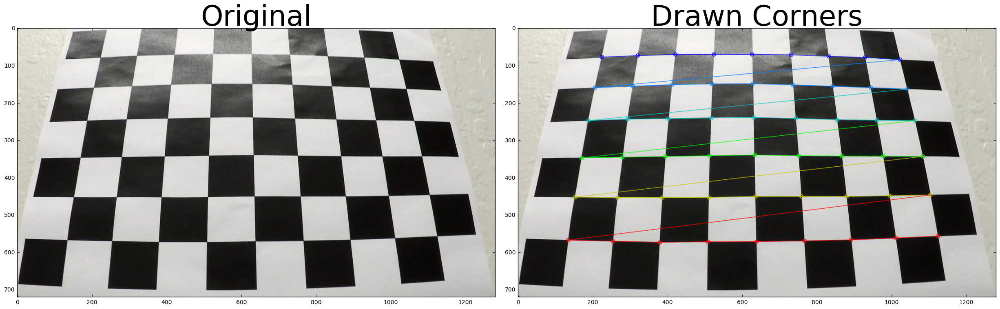

In [2]:
# Prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = mpimg.imread(fname)
    gray = grayscale(img)
        
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        cv2.imshow('img',img)
        cv2.waitKey(500)
    
        # Grab calibration image 3
        if fname == 'camera_cal\calibration3.jpg':
            exmpl_img = img
            
cv2.destroyAllWindows()

# Compute calibration matrix and distortion coefficients
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

# Plot calibration image 3 before/after drawn corners
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(mpimg.imread('camera_cal/calibration3.jpg'))
ax1.set_title('Original', fontsize=50)
ax2.imshow(exmpl_img)
ax2.set_title('Drawn Corners', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### 3. Apply distortion correction to raw images

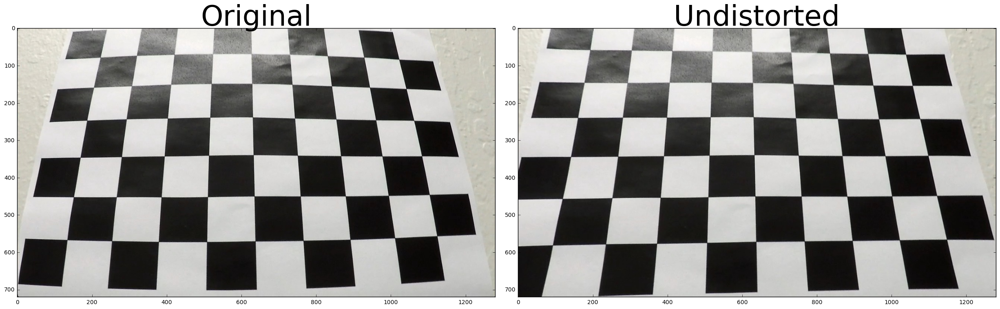

In [3]:
# Undistort using cv2.undistort(img, mtx, dist, None, None)
# NOTE: cv2.imread uses BGR whereas mpimg.imread uses RGB
img = mpimg.imread('camera_cal/calibration3.jpg')
undist = undistort(img, mtx, dist)

# Undistortion correction to calibration image 3
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original', fontsize=50)
ax2.imshow(undist)
ax2.set_title('Undistorted', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

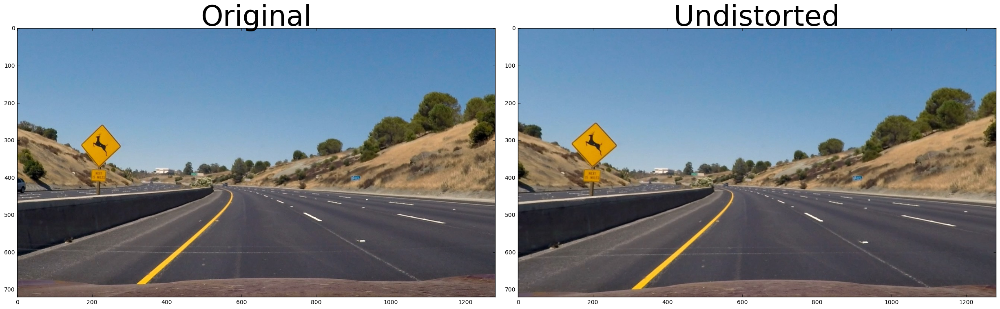

In [4]:
# Undistort using cv2.undistort(img, mtx, dist, None, None)
# NOTE: cv2.imread uses BGR whereas mpimg.imread uses RGB
img = mpimg.imread('test_images/test2.jpg')
undist = undistort(img, mtx, dist)

# Undistortion correction to test image 2
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original', fontsize=50)
ax2.imshow(undist)
ax2.set_title('Undistorted', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### 4. Use color transforms, gradients, etc., to create a thresholded binary image

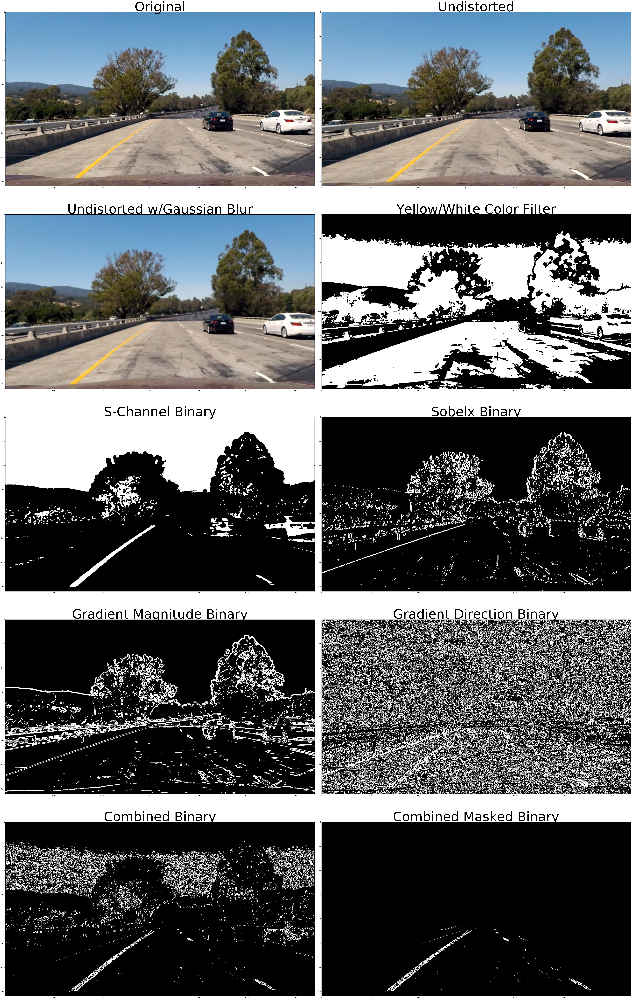

In [5]:
# Read in image
img = mpimg.imread('test_images/test1.jpg')
# Undistort image
undist = undistort(img, mtx, dist)
plot_undist = undist
# Apply Gaussian blur
undist = gaussian_blur(undist, 5)
# Binary output filter for white and yellow colors
y_w_col_fil = y_w_color_filter(undist)
# Apply HLS color space to binary output
s_channel_binary = hls_select(undist, 's', (100, 255))
# Apply Sobel threshold to binary output
sobelx_binary = sobel_thresh(undist, 'x', (20, 100))
# Apply gradient magnitude threshold to binary output
mag_binary = mag_thresh(undist, 5, (30, 100))
# Apply gradient direction threshold to binary output
dir_binary = dir_thresh(undist, 3, (0.7, 1.3))
# Combine the binary thresholds
combined_binary = np.zeros_like(sobelx_binary)
combined_binary[((((sobelx_binary == 1) & (mag_binary == 1)) | ((s_channel_binary == 1) & (dir_binary == 1))) & (y_w_col_fil == 1))] = 1
# Define vertices for mask
imshape = undist.shape
vertices_mask = np.array([[(imshape[1]*.05,imshape[0]),(imshape[1]*.40, imshape[0]*.60), (imshape[1]*.60, imshape[0]*.60), (imshape[1]*.95,imshape[0])]], dtype=np.int32)
masked = mask(combined_binary, vertices_mask)

# Thresholded binary image of test image 1
f, ((ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7, ax8), (ax9, ax10)) = plt.subplots(5, 2, figsize=(50, 40))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original', fontsize=75)
ax2.imshow(plot_undist)
ax2.set_title('Undistorted', fontsize=75)
ax3.imshow(undist)
ax3.set_title('Undistorted w/Gaussian Blur', fontsize=75)
ax4.imshow(y_w_col_fil, cmap='gray')
ax4.set_title('Yellow/White Color Filter', fontsize=75)
ax5.imshow(s_channel_binary, cmap='gray')
ax5.set_title('S-Channel Binary', fontsize=75)
ax6.imshow(sobelx_binary, cmap='gray')
ax6.set_title('Sobelx Binary', fontsize=75)
ax7.imshow(mag_binary, cmap='gray')
ax7.set_title('Gradient Magnitude Binary', fontsize=75)
ax8.imshow(dir_binary, cmap='gray')
ax8.set_title('Gradient Direction Binary', fontsize=75)
ax9.imshow(combined_binary, cmap='gray')
ax9.set_title('Combined Binary', fontsize=75)
ax10.imshow(masked, cmap='gray')
ax10.set_title('Combined Masked Binary', fontsize=75)
plt.subplots_adjust(left=0., right=1, top=2.0, bottom=0.)

### 5. Apply a perspective transform to rectify a binary image ("birds-eye view")

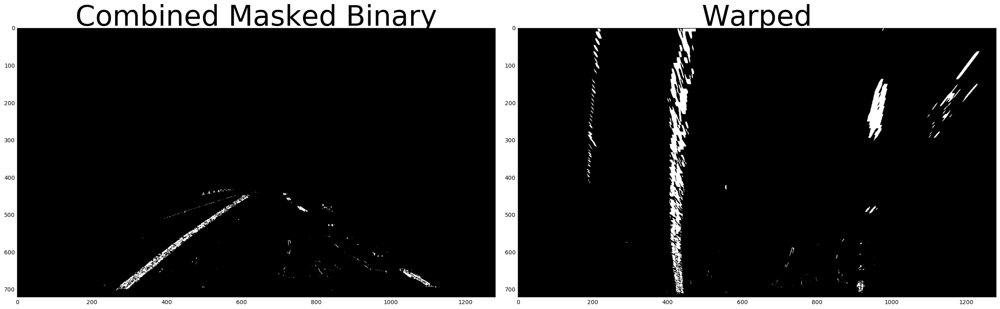

In [6]:
# Continue with the combined masked image from the previous code block
# Defining the region of interest and for warp
imshape = undist.shape
vertices = np.array([[(imshape[1]*.03,imshape[0]),(imshape[1]*.43, imshape[0]*.65), (imshape[1]*.57, imshape[0]*.65), (imshape[1]*.97,imshape[0])]], dtype=np.int32)
warped, M, Minv = warp(masked, vertices)

# Previous combined masked image and warped test image 1
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(masked, cmap='gray')
ax1.set_title('Combined Masked Binary', fontsize=50)
ax2.imshow(warped, cmap='gray')
ax2.set_title('Warped', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### 6. Detect lane pixels and fit to find the lane boundary

C:\Users\Doug\Anaconda3\lib\site-packages\ipykernel\__main__.py:135: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


(720, 0)

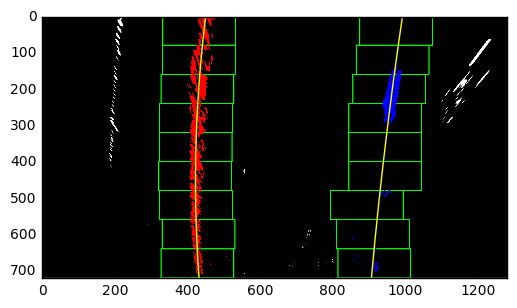

In [7]:
set_prev = 0
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50
# Choose the number of sliding windows
nwindows = 9
# Set height of windows
window_height = np.int(warped.shape[0]/nwindows)
# Fit lane lines
out_img, left_lane_inds, right_lane_inds, left_fit, right_fit, left_fitx, right_fitx, ploty, left_curverad, right_curverad, car_pos = fit_lines(warped, margin, minpix, nwindows, window_height)
# Plot the lane fit       
plt.imshow(out_img)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

### 7. Determine the curvature of the lane and vehicle position with respect to center

In [8]:
# Find the curvature of left and right lane lines from
# the example in the previous code block
curve_radii = 'Curvature:\nL: ' + str(np.round(left_curverad,2)) + ' m\nR: ' + str(np.round(right_curverad,2)) +' m'
# Now our radius of curvature is in meters
print(curve_radii)

# Assuming the camera in the car is directly in the center (i.e. true center = image.shape[1]/2)
car_pos_text = 'Car Pos: ' + str(np.round(car_pos,3)) + ' m'
print(car_pos_text)

Curvature:
L: 1203.32 m
R: 4159.75 m
Car Pos: 0.153 m


### 8. Warp the detected lane boundaries back onto the original image

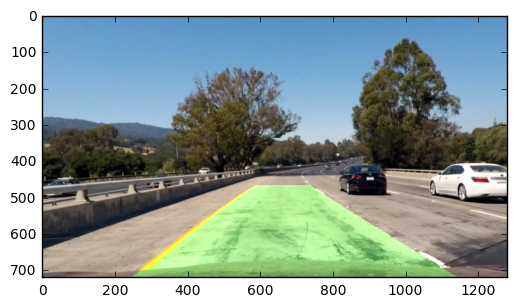

In [9]:
# Create an image to draw the lines on
warp_zero = np.zeros_like(warped).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

# Warp the blank back to original image space using inverse perspective matrix (Minv)
newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0])) 
# Combine the result with the original image
result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
plt.imshow(result)

### 9. Output visual display of lane boundaries, numerical estimation of lane curvature, and vehicle position

C:\Users\Doug\Anaconda3\lib\site-packages\ipykernel\__main__.py:135: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


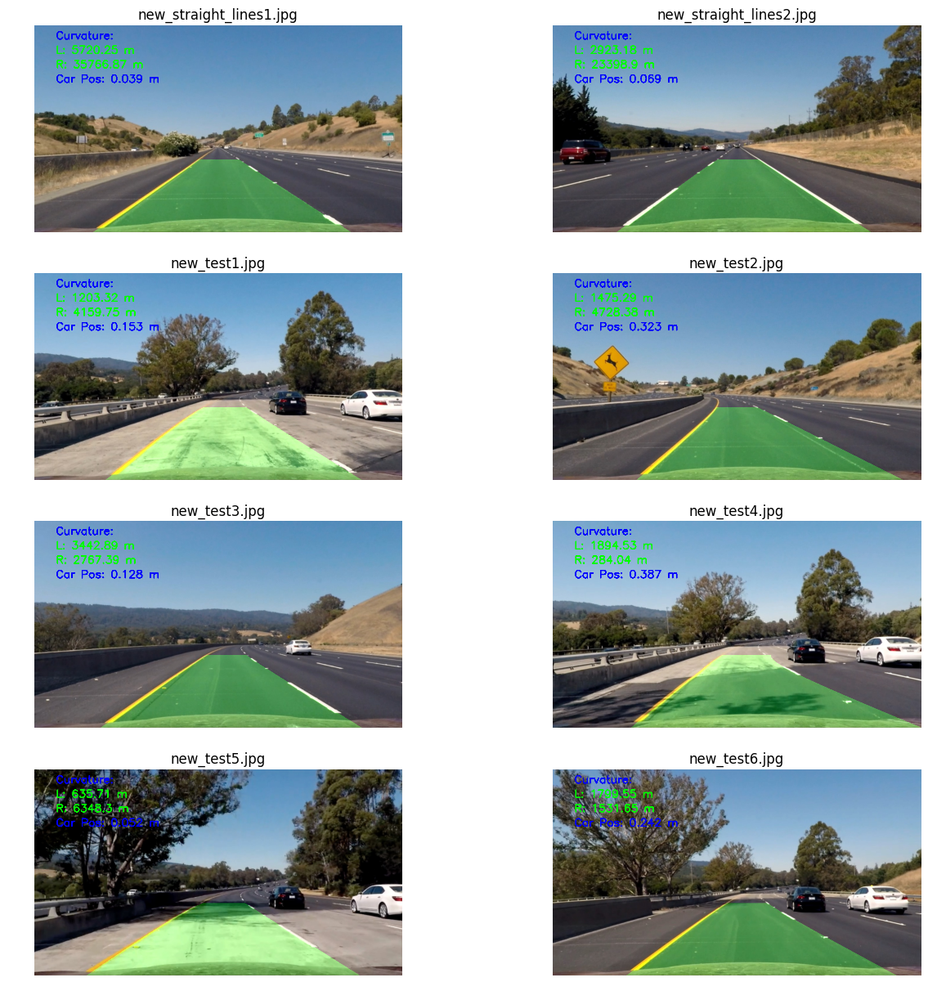

In [10]:
# Set up plotting area
plt.figure(figsize=(15,15))
i = 1
for image in os.listdir('test_images/'):
    set_prev = 0
    img = mpimg.imread('test_images/' + image)
    img = pipeline(img)
    plt.subplot(4, 2, i).set_title('new_' + image)
    plt.imshow(img)
    plt.axis('off')
    plt.imsave('output_images/new_' + image, img)
    i += 1

### 10. Run pipeline on project video

In [11]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML
set_prev = 0
project_output = 'new_project_video.mp4'
clip1 = VideoFileClip('project_video.mp4')
project_clip = clip1.fl_image(pipeline)
%time project_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video new_project_video.mp4
[MoviePy] Writing video new_project_video.mp4


100%|█████████████████████████████████████▉| 1260/1261 [06:22<00:00,  3.34it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: new_project_video.mp4 

Wall time: 6min 23s
